## Import libraries and load the datasets

In [1]:
import numpy as np  # Linear algebra
import pandas as pd  # Data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler
from datetime import datetime
import calendar
import warnings
from tqdm import tqdm
import plotly.express as px
from sklearn.linear_model import LinearRegression
from datetime import datetime

In [2]:
train_dataset = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/train.csv', parse_dates=['date'])
test_dataset  = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/test.csv', parse_dates=['date'])
store_dataset = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/stores.csv')
oil_dataset   = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/oil.csv',parse_dates=['date'])
holiday_dataset  = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/holidays_events.csv', parse_dates=['date'])
transactions_dataset = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/transactions.csv', parse_dates=['date'])


## Now it's time to check the train dataset.

In [3]:
train_dataset.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [4]:
train_dataset.isna().sum()

id             0
date           0
store_nbr      0
family         0
sales          0
onpromotion    0
dtype: int64

In [5]:
train_dataset.shape

(3000888, 6)

In [6]:
train_dataset.describe()

,id,date,store_nbr,sales,onpromotion
count,3.000888e+06,3000888,3.000888e+06,3.000888e+06,3.000888e+06
mean,1.500444e+06,2015-04-24 08:27:04.703088384,2.750000e+01,3.577757e+02,2.602770e+00
min,0.000000e+00,2013-01-01 00:00:00,1.000000e+00,0.000000e+00,0.000000e+00
25%,7.502218e+05,2014-02-26 18:00:00,1.400000e+01,0.000000e+00,0.000000e+00
50%,1.500444e+06,2015-04-24 12:00:00,2.750000e+01,1.100000e+01,0.000000e+00
75%,2.250665e+06,2016-06-19 06:00:00,4.100000e+01,1.958473e+02,0.000000e+00
max,3.000887e+06,2017-08-15 00:00:00,5.400000e+01,1.247170e+05,7.410000e+02
std,8.662819e+05,NaN,1.558579e+01,1.101998e+03,1.221888e+01


In [7]:
day1 = train_dataset['date'].min().strftime('%Y-%m-%d')
last_day = train_dataset['date'].max().strftime('%Y-%m-%d')

day1, last_day

('2013-01-01', '2017-08-15')

## Now it's time to check the test dataset.

In [8]:
test_dataset.head()

,id,date,store_nbr,family,onpromotion
0,3000888,2017-08-16,1,AUTOMOTIVE,0
1,3000889,2017-08-16,1,BABY CARE,0
2,3000890,2017-08-16,1,BEAUTY,2
3,3000891,2017-08-16,1,BEVERAGES,20
4,3000892,2017-08-16,1,BOOKS,0


In [9]:
test_dataset.isna().sum()

id             0
date           0
store_nbr      0
family         0
onpromotion    0
dtype: int64

In [10]:
test_dataset.shape

(28512, 5)

In [11]:
test_dataset.describe()

,id,date,store_nbr,onpromotion
count,2.851200e+04,28512,28512.000000,28512.000000
mean,3.015144e+06,2017-08-23 12:00:00,27.500000,6.965383
min,3.000888e+06,2017-08-16 00:00:00,1.000000,0.000000
25%,3.008016e+06,2017-08-19 18:00:00,14.000000,0.000000
50%,3.015144e+06,2017-08-23 12:00:00,27.500000,0.000000
75%,3.022271e+06,2017-08-27 06:00:00,41.000000,6.000000
max,3.029399e+06,2017-08-31 00:00:00,54.000000,646.000000
std,8.230850e+03,NaN,15.586057,20.683952


In [12]:
test_day1 = test_dataset['date'].min().strftime('%Y-%m-%d')
test_last_day = test_dataset['date'].max().strftime('%Y-%m-%d')

test_day1, test_last_day

('2017-08-16', '2017-08-31')

## Now it's time to check the store dataset.

In [13]:
store_dataset.isna().sum()

store_nbr    0
city         0
state        0
type         0
cluster      0
dtype: int64

In [14]:
store_dataset.shape

(54, 5)

In [15]:
store_dataset.describe()

,store_nbr,cluster
count,54.000000,54.000000
mean,27.500000,8.481481
std,15.732133,4.693395
min,1.000000,1.000000
25%,14.250000,4.000000
50%,27.500000,8.500000
75%,40.750000,13.000000
max,54.000000,17.000000


## Now it's time to check the oil dataset.

In [16]:
oil_dataset.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [17]:
oil_dataset.shape

(1218, 2)

In [18]:
oil_dataset.isna().sum()

date           0
dcoilwtico    43
dtype: int64

In [19]:
oil_dataset['dcoilwtico'] = oil_dataset['dcoilwtico'].fillna(method='ffill')
oil_dataset['dcoilwtico'] = oil_dataset['dcoilwtico'].fillna(method='bfill')

In [20]:
oil_dataset.isna().sum()

date          0
dcoilwtico    0
dtype: int64

In [21]:
oil_dataset.describe()

,date,dcoilwtico
count,1218,1218.000000
mean,2015-05-02 12:00:00,67.692159
min,2013-01-01 00:00:00,26.190000
25%,2014-03-03 06:00:00,46.422500
50%,2015-05-02 12:00:00,53.200000
75%,2016-06-30 18:00:00,95.685000
max,2017-08-31 00:00:00,110.620000
std,NaN,25.629744


## Now it's time to check the Holiday dataset.

In [22]:
holiday_dataset.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [23]:
holiday_dataset.isna().sum()

date           0
type           0
locale         0
locale_name    0
description    0
transferred    0
dtype: int64

In [24]:
holiday_dataset.shape

(350, 6)

In [25]:
holiday_dataset.describe()

,date
count,350
mean,2015-04-24 00:45:15.428571392
min,2012-03-02 00:00:00
25%,2013-12-23 06:00:00
50%,2015-06-08 00:00:00
75%,2016-07-03 00:00:00
max,2017-12-26 00:00:00


## Now it's time to check the Transactions dataset.

In [26]:
transactions_dataset.isna().sum()

date            0
store_nbr       0
transactions    0
dtype: int64

In [27]:
transactions_dataset.shape

(83488, 3)

In [28]:
transactions_dataset.describe()

,date,store_nbr,transactions
count,83488,83488.000000,83488.000000
mean,2015-05-20 16:07:40.866232064,26.939237,1694.602158
min,2013-01-01 00:00:00,1.000000,5.000000
25%,2014-03-27 00:00:00,13.000000,1046.000000
50%,2015-06-08 00:00:00,27.000000,1393.000000
75%,2016-07-14 06:00:00,40.000000,2079.000000
max,2017-08-15 00:00:00,54.000000,8359.000000
std,NaN,15.608204,963.286644


In [29]:
train = train_dataset.copy()
stores = train.groupby(['date', 'store_nbr'], as_index=False)['sales'].sum()

In [30]:
train.shape

(3000888, 6)

In [31]:
px.line(stores, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

It can be observed that from April 16-17, 2016, sales grew significantly, due to the earthquake that struck Ecuador on that date. That is why later this data will be removed. Also, there are stores that were opened after 2013, others since 2015 and so on, so everything before those dates should be removed.

In [32]:
train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]

In [33]:
start_date = '2016-04-16'
end_date = '2016-05-02'

filtered_data = train[(train['date'] >= start_date) & (train['date'] <= end_date)] # Filter the data in the date range
mean_sales_by_class = filtered_data.groupby('store_nbr')['sales'].mean().reset_index() # Grouping by class and calculating the average
mean_sales_by_class.rename(columns={'sales': 'mean_sales'}, inplace=True) # Rename the sales column for the union

train = train.merge(mean_sales_by_class, on='store_nbr', how='left')# Join DataFrames and replace values
train.loc[(train['date'] >= start_date) & (train['date'] <= end_date), 'sales'] = train['mean_sales']
train.drop('mean_sales', axis=1, inplace=True)

In [34]:
stores2 = train.groupby(['date', 'store_nbr'], as_index=False)['sales'].sum()
px.line(stores2, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

In [35]:
train.shape

(2780316, 6)

Let's check what happens with the oil

<AxesSubplot:xlabel='date'>

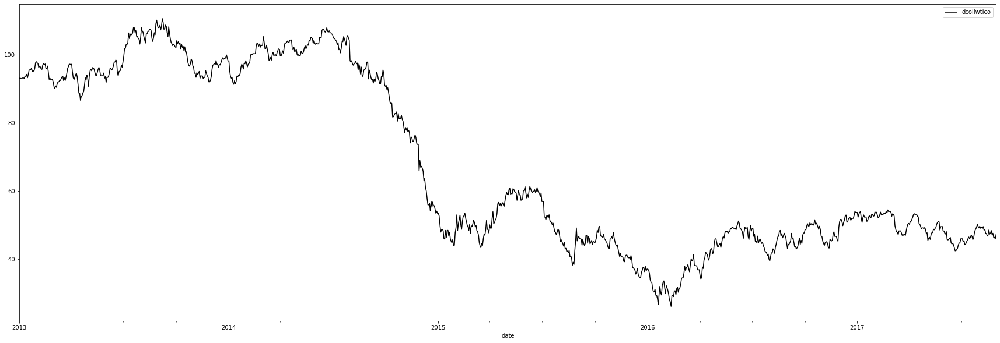

In [36]:
oil_dataset.set_index('date').plot(figsize = (30,10),color='black')

In [37]:
oil_dataset['date'] = pd.to_datetime(oil_dataset['date'])
oil_dataset.set_index('date', inplace=True)

In [38]:
train_store = pd.merge(train, store_dataset, on='store_nbr', how='left')
test_store = pd.merge(test_dataset, store_dataset, on='store_nbr', how='left')

In [39]:
train_store

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster
0,0,2013-01-01,1,AUTOMOTIVE,0.000,0,Quito,Pichincha,D,13
1,1,2013-01-01,1,BABY CARE,0.000,0,Quito,Pichincha,D,13
2,2,2013-01-01,1,BEAUTY,0.000,0,Quito,Pichincha,D,13
3,3,2013-01-01,1,BEVERAGES,0.000,0,Quito,Pichincha,D,13
4,4,2013-01-01,1,BOOKS,0.000,0,Quito,Pichincha,D,13
...,...,...,...,...,...,...,...,...,...,...
2780311,3000883,2017-08-15,9,POULTRY,438.133,0,Quito,Pichincha,B,6
2780312,3000884,2017-08-15,9,PREPARED FOODS,154.553,1,Quito,Pichincha,B,6
2780313,3000885,2017-08-15,9,PRODUCE,2419.729,148,Quito,Pichincha,B,6
2780314,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8,Quito,Pichincha,B,6


In [40]:
test_store

,id,date,store_nbr,family,onpromotion,city,state,type,cluster
0,3000888,2017-08-16,1,AUTOMOTIVE,0,Quito,Pichincha,D,13
1,3000889,2017-08-16,1,BABY CARE,0,Quito,Pichincha,D,13
2,3000890,2017-08-16,1,BEAUTY,2,Quito,Pichincha,D,13
3,3000891,2017-08-16,1,BEVERAGES,20,Quito,Pichincha,D,13
4,3000892,2017-08-16,1,BOOKS,0,Quito,Pichincha,D,13
...,...,...,...,...,...,...,...,...,...
28507,3029395,2017-08-31,9,POULTRY,1,Quito,Pichincha,B,6
28508,3029396,2017-08-31,9,PREPARED FOODS,0,Quito,Pichincha,B,6
28509,3029397,2017-08-31,9,PRODUCE,1,Quito,Pichincha,B,6
28510,3029398,2017-08-31,9,SCHOOL AND OFFICE SUPPLIES,9,Quito,Pichincha,B,6


In [41]:
train_oil = pd.merge(train_store, oil_dataset, on='date', how='left')
test_oil = pd.merge(test_store, oil_dataset, on='date', how='left')

In [42]:
train_oil

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico
0,0,2013-01-01,1,AUTOMOTIVE,0.000,0,Quito,Pichincha,D,13,93.14
1,1,2013-01-01,1,BABY CARE,0.000,0,Quito,Pichincha,D,13,93.14
2,2,2013-01-01,1,BEAUTY,0.000,0,Quito,Pichincha,D,13,93.14
3,3,2013-01-01,1,BEVERAGES,0.000,0,Quito,Pichincha,D,13,93.14
4,4,2013-01-01,1,BOOKS,0.000,0,Quito,Pichincha,D,13,93.14
...,...,...,...,...,...,...,...,...,...,...,...
2780311,3000883,2017-08-15,9,POULTRY,438.133,0,Quito,Pichincha,B,6,47.57
2780312,3000884,2017-08-15,9,PREPARED FOODS,154.553,1,Quito,Pichincha,B,6,47.57
2780313,3000885,2017-08-15,9,PRODUCE,2419.729,148,Quito,Pichincha,B,6,47.57
2780314,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8,Quito,Pichincha,B,6,47.57


In [43]:
train_transactions = pd.merge(train_oil, transactions_dataset, on=['date','store_nbr'],
                                         how='left')
test_transactions = pd.merge(test_oil, transactions_dataset, on=['date','store_nbr'],
                                         how='left')

In [44]:
train_transactions.isna().sum()

id                   0
date                 0
store_nbr            0
family               0
sales                0
onpromotion          0
city                 0
state                0
type                 0
cluster              0
dcoilwtico      794211
transactions     25212
dtype: int64

In [45]:
train_transactions['dcoilwtico'].fillna(0, inplace=True)
train_transactions['transactions'].fillna(0, inplace=True)

In [46]:
train_transactions.isna().sum()

id              0
date            0
store_nbr       0
family          0
sales           0
onpromotion     0
city            0
state           0
type            0
cluster         0
dcoilwtico      0
transactions    0
dtype: int64

In [47]:
train_transactions

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,transactions
0,0,2013-01-01,1,AUTOMOTIVE,0.000,0,Quito,Pichincha,D,13,93.14,0.0
1,1,2013-01-01,1,BABY CARE,0.000,0,Quito,Pichincha,D,13,93.14,0.0
2,2,2013-01-01,1,BEAUTY,0.000,0,Quito,Pichincha,D,13,93.14,0.0
3,3,2013-01-01,1,BEVERAGES,0.000,0,Quito,Pichincha,D,13,93.14,0.0
4,4,2013-01-01,1,BOOKS,0.000,0,Quito,Pichincha,D,13,93.14,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2780311,3000883,2017-08-15,9,POULTRY,438.133,0,Quito,Pichincha,B,6,47.57,2155.0
2780312,3000884,2017-08-15,9,PREPARED FOODS,154.553,1,Quito,Pichincha,B,6,47.57,2155.0
2780313,3000885,2017-08-15,9,PRODUCE,2419.729,148,Quito,Pichincha,B,6,47.57,2155.0
2780314,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8,Quito,Pichincha,B,6,47.57,2155.0


In [48]:
test_transactions['dcoilwtico'].fillna(0, inplace=True)
test_transactions['transactions'].fillna(0, inplace=True)

In [49]:
test_transactions.isna().sum()

id              0
date            0
store_nbr       0
family          0
onpromotion     0
city            0
state           0
type            0
cluster         0
dcoilwtico      0
transactions    0
dtype: int64

In [50]:
test_transactions

,id,date,store_nbr,family,onpromotion,city,state,type,cluster,dcoilwtico,transactions
0,3000888,2017-08-16,1,AUTOMOTIVE,0,Quito,Pichincha,D,13,46.80,0.0
1,3000889,2017-08-16,1,BABY CARE,0,Quito,Pichincha,D,13,46.80,0.0
2,3000890,2017-08-16,1,BEAUTY,2,Quito,Pichincha,D,13,46.80,0.0
3,3000891,2017-08-16,1,BEVERAGES,20,Quito,Pichincha,D,13,46.80,0.0
4,3000892,2017-08-16,1,BOOKS,0,Quito,Pichincha,D,13,46.80,0.0
...,...,...,...,...,...,...,...,...,...,...,...
28507,3029395,2017-08-31,9,POULTRY,1,Quito,Pichincha,B,6,47.26,0.0
28508,3029396,2017-08-31,9,PREPARED FOODS,0,Quito,Pichincha,B,6,47.26,0.0
28509,3029397,2017-08-31,9,PRODUCE,1,Quito,Pichincha,B,6,47.26,0.0
28510,3029398,2017-08-31,9,SCHOOL AND OFFICE SUPPLIES,9,Quito,Pichincha,B,6,47.26,0.0


In [51]:
datatrain2 = train_transactions.copy()
datatest2 = test_transactions.copy()
datatrain2.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,transactions
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,93.14,0.0
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,93.14,0.0
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,93.14,0.0
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,93.14,0.0
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,93.14,0.0


In [52]:
datatrain2 = datatrain2.drop('id', axis=1)
datatrain2.head()

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,transactions
0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,93.14,0.0
1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,93.14,0.0
2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,93.14,0.0
3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,93.14,0.0
4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,93.14,0.0


In [53]:
datatrain2 = datatrain2.drop('transactions', axis=1) #It makes noise, it has nothing to do with predicting sales.

In [54]:
def add_features(df):
    df['date'] = pd.to_datetime(df['date'])  
    df['weekday'] = df['date'].dt.weekday
    df['year'] = df['date'].dt.year
    df['month'] = df['date'].dt.month
    df['day'] = df['date'].dt.day
    df['eomd'] = df['date'].apply(lambda x: calendar.monthrange(x.year, x.month)[1])
    df['payday'] = ((df['day'] == 15) | (df['day'] == df['eomd'])).astype(int)
    df['is_weekend'] = df['weekday'].isin([5, 6]).astype(int)
    df.drop(['eomd'], axis=1, inplace=True)  
    return df

datatrain2 = add_features(datatrain2)
datatest2 = add_features(datatest2)

In [55]:
datatrain2

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,weekday,year,month,day,payday,is_weekend
0,2013-01-01,1,AUTOMOTIVE,0.000,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
1,2013-01-01,1,BABY CARE,0.000,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
2,2013-01-01,1,BEAUTY,0.000,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
3,2013-01-01,1,BEVERAGES,0.000,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
4,2013-01-01,1,BOOKS,0.000,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2780311,2017-08-15,9,POULTRY,438.133,0,Quito,Pichincha,B,6,47.57,1,2017,8,15,1,0
2780312,2017-08-15,9,PREPARED FOODS,154.553,1,Quito,Pichincha,B,6,47.57,1,2017,8,15,1,0
2780313,2017-08-15,9,PRODUCE,2419.729,148,Quito,Pichincha,B,6,47.57,1,2017,8,15,1,0
2780314,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8,Quito,Pichincha,B,6,47.57,1,2017,8,15,1,0


In [56]:
datatest2 = datatest2.drop(['id','transactions'], axis=1)

In [57]:
datatest2

,date,store_nbr,family,onpromotion,city,state,type,cluster,dcoilwtico,weekday,year,month,day,payday,is_weekend
0,2017-08-16,1,AUTOMOTIVE,0,Quito,Pichincha,D,13,46.80,2,2017,8,16,0,0
1,2017-08-16,1,BABY CARE,0,Quito,Pichincha,D,13,46.80,2,2017,8,16,0,0
2,2017-08-16,1,BEAUTY,2,Quito,Pichincha,D,13,46.80,2,2017,8,16,0,0
3,2017-08-16,1,BEVERAGES,20,Quito,Pichincha,D,13,46.80,2,2017,8,16,0,0
4,2017-08-16,1,BOOKS,0,Quito,Pichincha,D,13,46.80,2,2017,8,16,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28507,2017-08-31,9,POULTRY,1,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0
28508,2017-08-31,9,PREPARED FOODS,0,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0
28509,2017-08-31,9,PRODUCE,1,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0
28510,2017-08-31,9,SCHOOL AND OFFICE SUPPLIES,9,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0


In [58]:
def add_lag(df, lags):
    for lag in lags:
        df[f'sales_lag_{lag}'] = df.groupby(['store_nbr', 'family'])['sales'].transform(lambda x: x.shift(lag))
    return df

def add_rolling_mean(df, windows):
    for window in windows:
        df[f'sales_roll_mean_{window}'] = df.groupby(['store_nbr', 'family'])['sales'].transform(
            lambda x: x.shift(1).rolling(window=window, min_periods=1).mean()) + add_noise(df)
    return df

def add_ewm(df, alphas, lags):
    for alpha in alphas:
        for lag in lags:
            df[f'sales_ewm_alpha_{str(alpha).replace(".", "")}_lag_{lag}'] = df.groupby(['store_nbr', 'family'])['sales'].transform(
                lambda x: x.shift(lag).ewm(alpha=alpha).mean())
    return df

def add_noise(df):
    return np.random.normal(scale=2.0, size=(len(df),))

In [59]:
dataset_completo = pd.concat([datatrain2, datatest2], axis=0, ignore_index=True)

In [60]:
dataset_completo

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,weekday,year,month,day,payday,is_weekend
0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,93.14,1,2013,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2808823,2017-08-31,9,POULTRY,NaN,1,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0
2808824,2017-08-31,9,PREPARED FOODS,NaN,0,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0
2808825,2017-08-31,9,PRODUCE,NaN,1,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0
2808826,2017-08-31,9,SCHOOL AND OFFICE SUPPLIES,NaN,9,Quito,Pichincha,B,6,47.26,3,2017,8,31,1,0


In [61]:
lags = [7, 14, 30]
windows = [7, 30]
ewm_alphas = [0.95, 0.9, 0.8]
ewm_lags = [7, 30]

dataset_completo = add_lag(dataset_completo, lags)
dataset_completo = add_rolling_mean(dataset_completo, windows)
dataset_completo = add_ewm(dataset_completo, ewm_alphas, ewm_lags)

In [62]:
dataset_completo.fillna(0, inplace=True)

In [63]:
train_data = dataset_completo[dataset_completo['date'] <= '2017-08-15'].copy()
test_data = dataset_completo[dataset_completo['date'] > '2017-08-15'].copy()

In [64]:
c_feat = ['family', 'city', 'state', 'type', 'cluster', 'store_nbr']

train_data_enc = train_data
test_data_enc = test_data

train_data_enc[c_feat] = train_data_enc[c_feat].astype(str)
test_data_enc[c_feat] = test_data_enc[c_feat].astype(str)

label_encoders = {}
for col in c_feat:
    le = LabelEncoder()
    train_data_enc[col] = le.fit_transform(train_data[col])
    test_data_enc[col] = le.transform(test_data[col])
    label_encoders[col] = le

In [65]:
train_data_enc.head()

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,...,sales_lag_14,sales_lag_30,sales_roll_mean_7,sales_roll_mean_30,sales_ewm_alpha_095_lag_7,sales_ewm_alpha_095_lag_30,sales_ewm_alpha_09_lag_7,sales_ewm_alpha_09_lag_30,sales_ewm_alpha_08_lag_7,sales_ewm_alpha_08_lag_30
0,2013-01-01,0,0,0.0,0,18,12,3,4,93.14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2013-01-01,0,1,0.0,0,18,12,3,4,93.14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2013-01-01,0,2,0.0,0,18,12,3,4,93.14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2013-01-01,0,3,0.0,0,18,12,3,4,93.14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2013-01-01,0,4,0.0,0,18,12,3,4,93.14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [66]:
test_data_enc.nunique()

date                             16
store_nbr                        54
family                           33
sales                             1
onpromotion                     212
city                             22
state                            16
type                              5
cluster                          17
dcoilwtico                       12
weekday                           7
year                              1
month                             1
day                              16
payday                            2
is_weekend                        2
sales_lag_7                    3838
sales_lag_14                   6981
sales_lag_30                   7877
sales_roll_mean_7             12475
sales_roll_mean_30            28512
sales_ewm_alpha_095_lag_7     11907
sales_ewm_alpha_095_lag_30    26909
sales_ewm_alpha_09_lag_7      11961
sales_ewm_alpha_09_lag_30     27177
sales_ewm_alpha_08_lag_7      12093
sales_ewm_alpha_08_lag_30     27957
dtype: int64

In [67]:
train_data_enc.drop(['date'], axis=1, inplace=True)
test_data_enc.drop(['date'], axis=1, inplace=True)

In [68]:
# split data into X parameter and y as target
X = train_data_enc.drop('sales', axis=1)
Y = train_data_enc['sales'] #Sales values are stored

In [69]:
sub_frac = 0.20
sub_size = int(len(train_data_enc) * sub_frac)
sub_train_data = train_data_enc.iloc[-sub_size:]
X_sub = sub_train_data.drop(columns=["sales"])
y_sub = sub_train_data["sales"]
split_index = int(0.8 * len(X_sub))
X_sub_train, X_sub_val = X_sub.iloc[:split_index], X_sub.iloc[split_index:]
y_sub_train, y_sub_val = y_sub.iloc[:split_index], y_sub.iloc[split_index:]

In [70]:
X_sub_train


,store_nbr,family,onpromotion,city,state,type,cluster,dcoilwtico,weekday,year,...,sales_lag_14,sales_lag_30,sales_roll_mean_7,sales_roll_mean_30,sales_ewm_alpha_095_lag_7,sales_ewm_alpha_095_lag_30,sales_ewm_alpha_09_lag_7,sales_ewm_alpha_09_lag_30,sales_ewm_alpha_08_lag_7,sales_ewm_alpha_08_lag_30
2224253,15,20,0,0,15,3,16,48.80,0,2016,...,0.000,3.000,2.943738,2.366726,1.140243,2.904625,1.261890,2.817010,1.454090,2.656349
2224254,15,21,0,0,15,3,16,48.80,0,2016,...,5.000,3.000,6.171246,3.291172,3.959749,3.014740,3.937968,3.057877,3.942965,3.222909
2224255,15,22,0,0,15,3,16,48.80,0,2016,...,10.000,102.000,35.824166,48.152743,18.694221,100.267419,19.852470,98.999623,23.397018,97.439864
2224256,15,23,0,0,15,3,16,48.80,0,2016,...,3.000,7.000,5.934672,7.056525,8.854749,6.942269,8.717963,6.868308,8.462892,6.669013
2224257,15,24,0,0,15,3,16,48.80,0,2016,...,464.267,937.561,532.643387,528.147369,333.839627,919.926326,350.590773,902.810984,380.122449,869.362086
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2669098,31,25,15,12,8,3,11,44.79,2,2017,...,327.000,276.000,408.566867,395.299217,382.692886,282.564800,382.817104,289.237787,385.708620,302.173320
2669099,31,26,0,12,8,3,11,44.79,2,2017,...,13.000,6.000,7.764104,6.533647,12.508165,6.149280,12.035590,6.294468,11.167688,6.558949
2669100,31,27,0,12,8,3,11,44.79,2,2017,...,6.000,9.000,8.373200,13.827274,8.246353,9.336862,8.490592,9.644782,8.999754,10.156342
2669101,31,28,0,12,8,3,11,44.79,2,2017,...,129.766,102.120,163.671476,154.443927,144.814504,105.359477,142.682329,108.890740,139.005542,116.591112


In [71]:
X_sub_val

,store_nbr,family,onpromotion,city,state,type,cluster,dcoilwtico,weekday,year,...,sales_lag_14,sales_lag_30,sales_roll_mean_7,sales_roll_mean_30,sales_ewm_alpha_095_lag_7,sales_ewm_alpha_095_lag_30,sales_ewm_alpha_09_lag_7,sales_ewm_alpha_09_lag_30,sales_ewm_alpha_08_lag_7,sales_ewm_alpha_08_lag_30
2669103,31,30,182,12,8,3,11,44.79,2,2017,...,3100.723000,2087.228,2148.117542,2194.171214,3.076788e+03,2112.222254,3.006306e+03,2137.997922,2.872034e+03,2189.211287
2669104,31,31,0,12,8,3,11,44.79,2,2017,...,0.000000,0.000,-1.730613,-0.304716,2.906419e-20,0.000125,9.090099e-16,0.000990,2.727304e-11,0.007680
2669105,31,32,0,12,8,3,11,44.79,2,2017,...,16.041000,11.622,15.047145,17.812054,9.807021e+00,12.386494,9.800724e+00,13.157456,9.795243e+00,14.703066
2669106,32,0,0,3,0,1,13,44.79,2,2017,...,8.000000,5.000,9.574054,9.708823,6.959840e+00,5.010213,6.939375e+00,5.041422,6.963869e+00,5.167166
2669107,32,1,0,3,0,1,13,44.79,2,2017,...,0.000000,0.000,-0.325352,0.874885,7.125015e-03,0.002376,2.700090e-02,0.009019,9.605202e-02,0.032575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2780311,53,28,0,18,12,1,13,47.57,1,2017,...,570.196000,571.333,370.865470,427.691049,3.635538e+02,568.342793,3.696978e+02,564.910993,3.839708e+02,556.377248
2780312,53,29,1,18,12,1,13,47.57,1,2017,...,50.462997,125.960,117.218226,105.237922,1.133920e+02,126.753250,1.140108e+02,127.378549,1.157539e+02,128.059505
2780313,53,30,148,18,12,1,13,47.57,1,2017,...,2470.461000,2041.967,1511.806331,1593.259695,2.268981e+03,2026.020436,2.239195e+03,2007.645869,2.181927e+03,1963.919169
2780314,53,31,8,18,12,1,13,47.57,1,2017,...,203.000000,0.000,149.798463,77.645551,1.689173e+02,0.095601,1.680472e+02,0.184619,1.668051e+02,0.354174


In [72]:
y_sub_train

2224253      0.00000
2224254      5.00000
2224255     30.00000
2224256      2.00000
2224257    512.20700
             ...    
2669098    392.00000
2669099      3.00000
2669100     10.00000
2669101    130.44499
2669102     90.39100
Name: sales, Length: 444850, dtype: float64

In [73]:
y_sub_val

2669103    3292.113
2669104       0.000
2669105      16.652
2669106       9.000
2669107       0.000
             ...   
2780311     438.133
2780312     154.553
2780313    2419.729
2780314     121.000
2780315      16.000
Name: sales, Length: 111213, dtype: float64

In [74]:
# Define the Optuna objective function
def objective(trial):
    params = {
        # 'tree_method': 'gpu_hist',  
        'tree_method': 'hist',  
        'n_jobs': -1,  
        'objective': 'reg:squarederror',
        'n_estimators': trial.suggest_int('n_estimators', 100, 300),
        'verbosity': 2,
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1, log=True),
        'max_depth': trial.suggest_int('max_depth', 6, 14),
        'subsample': trial.suggest_float('subsample', 0.6, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 10, 24),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.001, 1, log=True),
        'colsample_bynode': trial.suggest_float('colsample_bynode', 0.3, 0.9)
    }

    model = xgb.XGBRegressor(**params)
    
    model.fit(X_sub_train, y_sub_train, eval_set=[(X_sub_val, y_sub_val)], verbose=10)
    y_pred = model.predict(X_sub_val)
    rmse = mean_squared_error(y_sub_val, y_pred, squared=False)
    return rmse

In [221]:
import optuna
# Create and optimize the study
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

[I 2024-09-24 11:48:23,836] A new study created in memory with name: no-name-5cbca059-aed8-473c-96f1-a26f42608d70


  Using cached typing_extensions-4.12.2-py3-none-any.whl (37 kB)
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 3.7.4.3
    Uninstalling typing-extensions-3.7.4.3:
      Successfully uninstalled typing-extensions-3.7.4.3
[0]	validation_0-rmse:1263.17726
[10]	validation_0-rmse:927.81752
[20]	validation_0-rmse:685.97674
[30]	validation_0-rmse:517.12289
[40]	validation_0-rmse:401.52054
[50]	validation_0-rmse:326.29905
[60]	validation_0-rmse:279.63914
[70]	validation_0-rmse:254.73066
[80]	validation_0-rmse:242.00556
[90]	validation_0-rmse:235.68210
[100]	validation_0-rmse:232.64770
[110]	validation_0-rmse:232.87556
[120]	validation_0-rmse:233.80662
[130]	validation_0-rmse:234.59401
[140]	validation_0-rmse:235.50646
[150]	validation_0-rmse:236.87766
[160]	validation_0-rmse:237.16284
[170]	validation_0-rmse:238.01588
[180]	validation_0-rmse:238.89105
[190]	validation_0-rmse:239.94140
[199]	validation_0-rmse:240.45423


[I 2024-09-24 11:48:35,561] Trial 0 finished with value: 240.4542306523302 and parameters: {'n_estimators': 200, 'learning_rate': 0.031065338310324722, 'max_depth': 10, 'subsample': 0.7911859587955324, 'colsample_bytree': 0.35153102079041143, 'min_child_weight': 20, 'reg_lambda': 0.001565686132561521, 'colsample_bynode': 0.7381078096942799}. Best is trial 0 with value: 240.4542306523302.


[0]	validation_0-rmse:1219.91416
[10]	validation_0-rmse:644.55055
[20]	validation_0-rmse:367.80380
[30]	validation_0-rmse:260.70752
[40]	validation_0-rmse:233.53132
[50]	validation_0-rmse:230.75151
[60]	validation_0-rmse:234.67735
[70]	validation_0-rmse:237.72813
[80]	validation_0-rmse:241.07592
[90]	validation_0-rmse:242.61972
[100]	validation_0-rmse:243.97176
[110]	validation_0-rmse:245.72842
[116]	validation_0-rmse:246.68532


[I 2024-09-24 11:48:41,713] Trial 1 finished with value: 246.6853195141644 and parameters: {'n_estimators': 117, 'learning_rate': 0.06336642478270658, 'max_depth': 9, 'subsample': 0.7504524840733682, 'colsample_bytree': 0.8134763132986811, 'min_child_weight': 24, 'reg_lambda': 0.001775010118255181, 'colsample_bynode': 0.6863293797054588}. Best is trial 0 with value: 240.4542306523302.


[0]	validation_0-rmse:1253.56326
[10]	validation_0-rmse:859.14330
[20]	validation_0-rmse:598.74879
[30]	validation_0-rmse:433.19970
[40]	validation_0-rmse:331.73284
[50]	validation_0-rmse:277.25611
[60]	validation_0-rmse:250.75663
[70]	validation_0-rmse:238.71044
[80]	validation_0-rmse:233.93337
[90]	validation_0-rmse:232.92849
[100]	validation_0-rmse:232.86181
[107]	validation_0-rmse:233.46253


[I 2024-09-24 11:48:46,185] Trial 2 finished with value: 233.462525330446 and parameters: {'n_estimators': 108, 'learning_rate': 0.03845215473666802, 'max_depth': 6, 'subsample': 0.8999715997177624, 'colsample_bytree': 0.7783806308728796, 'min_child_weight': 18, 'reg_lambda': 0.001613420081838701, 'colsample_bynode': 0.4384887115389177}. Best is trial 2 with value: 233.462525330446.


[0]	validation_0-rmse:1214.18893
[10]	validation_0-rmse:608.52941
[20]	validation_0-rmse:340.83563
[30]	validation_0-rmse:247.39462
[40]	validation_0-rmse:230.81555
[50]	validation_0-rmse:232.67419
[60]	validation_0-rmse:237.61236
[70]	validation_0-rmse:241.09514
[80]	validation_0-rmse:243.97546
[90]	validation_0-rmse:245.64461
[100]	validation_0-rmse:246.20660
[110]	validation_0-rmse:247.69346
[120]	validation_0-rmse:249.66427
[130]	validation_0-rmse:250.56743
[140]	validation_0-rmse:251.78234
[150]	validation_0-rmse:252.34130
[154]	validation_0-rmse:252.59289


[I 2024-09-24 11:48:56,429] Trial 3 finished with value: 252.59288638374716 and parameters: {'n_estimators': 155, 'learning_rate': 0.06802861771440158, 'max_depth': 13, 'subsample': 0.7516161029943194, 'colsample_bytree': 0.7814968722273645, 'min_child_weight': 23, 'reg_lambda': 0.0032059966122648595, 'colsample_bynode': 0.32865053937889244}. Best is trial 2 with value: 233.462525330446.


[0]	validation_0-rmse:1286.90869
[10]	validation_0-rmse:1136.53274
[20]	validation_0-rmse:1004.91342
[30]	validation_0-rmse:889.01716
[40]	validation_0-rmse:786.65850
[50]	validation_0-rmse:696.85750
[60]	validation_0-rmse:618.87901
[70]	validation_0-rmse:551.09057
[80]	validation_0-rmse:492.85614
[90]	validation_0-rmse:442.86184
[100]	validation_0-rmse:399.77178
[110]	validation_0-rmse:363.69019
[120]	validation_0-rmse:333.34374
[130]	validation_0-rmse:308.54605
[140]	validation_0-rmse:288.33606
[150]	validation_0-rmse:272.27979
[160]	validation_0-rmse:259.71937
[164]	validation_0-rmse:255.63662


[I 2024-09-24 11:49:07,124] Trial 4 finished with value: 255.6366163872131 and parameters: {'n_estimators': 165, 'learning_rate': 0.012356757631156543, 'max_depth': 10, 'subsample': 0.6827681148108359, 'colsample_bytree': 0.7852015432048611, 'min_child_weight': 11, 'reg_lambda': 0.12425090400936481, 'colsample_bynode': 0.7218020205445259}. Best is trial 2 with value: 233.462525330446.


[0]	validation_0-rmse:1252.64047
[10]	validation_0-rmse:847.90351
[20]	validation_0-rmse:581.47595
[30]	validation_0-rmse:413.49877
[40]	validation_0-rmse:314.28253
[50]	validation_0-rmse:262.65954
[60]	validation_0-rmse:239.05415
[70]	validation_0-rmse:230.94231
[80]	validation_0-rmse:229.32346
[90]	validation_0-rmse:230.41550
[100]	validation_0-rmse:232.08427
[101]	validation_0-rmse:232.22311


[I 2024-09-24 11:49:13,052] Trial 5 finished with value: 232.2231105679051 and parameters: {'n_estimators': 102, 'learning_rate': 0.03898328580347557, 'max_depth': 10, 'subsample': 0.9198347778200742, 'colsample_bytree': 0.6778891268431566, 'min_child_weight': 19, 'reg_lambda': 0.0063891513721647825, 'colsample_bynode': 0.3727824150583263}. Best is trial 5 with value: 232.2231105679051.


[0]	validation_0-rmse:1239.17141
[10]	validation_0-rmse:753.46616
[20]	validation_0-rmse:472.49893
[30]	validation_0-rmse:320.92911
[40]	validation_0-rmse:253.96994
[50]	validation_0-rmse:232.40284
[60]	validation_0-rmse:230.04406
[70]	validation_0-rmse:232.47649
[80]	validation_0-rmse:236.12491
[90]	validation_0-rmse:238.93982
[100]	validation_0-rmse:241.27489
[110]	validation_0-rmse:243.61790
[120]	validation_0-rmse:245.10310
[130]	validation_0-rmse:245.96747
[140]	validation_0-rmse:246.79154
[150]	validation_0-rmse:247.75851
[160]	validation_0-rmse:248.38997
[170]	validation_0-rmse:249.15604
[180]	validation_0-rmse:249.77817
[190]	validation_0-rmse:250.44421
[200]	validation_0-rmse:250.87539
[210]	validation_0-rmse:250.95929
[220]	validation_0-rmse:251.20990
[230]	validation_0-rmse:251.56885
[232]	validation_0-rmse:251.62709


[I 2024-09-24 11:49:27,696] Trial 6 finished with value: 251.6270851868489 and parameters: {'n_estimators': 233, 'learning_rate': 0.048894822838632265, 'max_depth': 13, 'subsample': 0.8208158344870562, 'colsample_bytree': 0.929577476968376, 'min_child_weight': 14, 'reg_lambda': 0.004790998457743749, 'colsample_bynode': 0.4324033920690218}. Best is trial 5 with value: 232.2231105679051.


[0]	validation_0-rmse:1277.87982
[10]	validation_0-rmse:1052.31689
[20]	validation_0-rmse:867.57537
[30]	validation_0-rmse:718.70736
[40]	validation_0-rmse:598.00493
[50]	validation_0-rmse:502.10793
[60]	validation_0-rmse:425.95197
[70]	validation_0-rmse:367.04671
[80]	validation_0-rmse:323.18008
[90]	validation_0-rmse:291.25707
[100]	validation_0-rmse:268.61306
[110]	validation_0-rmse:252.67430
[120]	validation_0-rmse:242.73070
[130]	validation_0-rmse:236.89599
[140]	validation_0-rmse:233.06380
[150]	validation_0-rmse:231.08461
[160]	validation_0-rmse:230.51785
[170]	validation_0-rmse:230.53107
[180]	validation_0-rmse:231.13444
[190]	validation_0-rmse:231.70764
[200]	validation_0-rmse:232.42149
[210]	validation_0-rmse:233.39674
[220]	validation_0-rmse:234.42151
[230]	validation_0-rmse:235.45016
[240]	validation_0-rmse:236.30730
[250]	validation_0-rmse:236.99700
[260]	validation_0-rmse:237.68112
[270]	validation_0-rmse:238.30967
[280]	validation_0-rmse:238.87732


[I 2024-09-24 11:49:40,321] Trial 7 finished with value: 238.8773185687529 and parameters: {'n_estimators': 281, 'learning_rate': 0.0194421159441089, 'max_depth': 8, 'subsample': 0.6566370142696688, 'colsample_bytree': 0.6308228955349335, 'min_child_weight': 19, 'reg_lambda': 0.0063850616749346325, 'colsample_bynode': 0.7033495756734451}. Best is trial 5 with value: 232.2231105679051.


[0]	validation_0-rmse:1277.89760
[10]	validation_0-rmse:1053.30713
[20]	validation_0-rmse:869.62925
[30]	validation_0-rmse:720.39220
[40]	validation_0-rmse:600.25213
[50]	validation_0-rmse:505.78286
[60]	validation_0-rmse:430.77242
[70]	validation_0-rmse:373.52746
[80]	validation_0-rmse:330.66272
[90]	validation_0-rmse:298.85373
[100]	validation_0-rmse:276.20379
[110]	validation_0-rmse:260.36905
[120]	validation_0-rmse:250.29184
[130]	validation_0-rmse:243.09567
[140]	validation_0-rmse:238.82733
[150]	validation_0-rmse:235.85489
[160]	validation_0-rmse:234.66632
[170]	validation_0-rmse:234.00208
[180]	validation_0-rmse:233.59691
[190]	validation_0-rmse:233.59890
[200]	validation_0-rmse:233.81074
[210]	validation_0-rmse:234.02590
[220]	validation_0-rmse:234.43607
[230]	validation_0-rmse:234.74917
[240]	validation_0-rmse:234.86610
[250]	validation_0-rmse:235.06810
[260]	validation_0-rmse:235.42442
[270]	validation_0-rmse:236.37430
[280]	validation_0-rmse:236.96884


[I 2024-09-24 11:49:51,034] Trial 8 finished with value: 236.96883465833656 and parameters: {'n_estimators': 281, 'learning_rate': 0.019578082903368696, 'max_depth': 7, 'subsample': 0.770612513098197, 'colsample_bytree': 0.5130463434099811, 'min_child_weight': 19, 'reg_lambda': 0.3163695294183683, 'colsample_bynode': 0.47316206000267463}. Best is trial 5 with value: 232.2231105679051.


[0]	validation_0-rmse:1281.27511
[10]	validation_0-rmse:1083.43112
[20]	validation_0-rmse:918.75003
[30]	validation_0-rmse:781.74990
[40]	validation_0-rmse:666.89364
[50]	validation_0-rmse:571.88218
[60]	validation_0-rmse:495.79232
[70]	validation_0-rmse:434.23070
[80]	validation_0-rmse:384.38070
[90]	validation_0-rmse:346.17352
[100]	validation_0-rmse:316.29330
[110]	validation_0-rmse:293.47128
[120]	validation_0-rmse:276.46978
[130]	validation_0-rmse:264.77171
[140]	validation_0-rmse:256.39790
[150]	validation_0-rmse:250.86792
[160]	validation_0-rmse:246.91602
[170]	validation_0-rmse:243.75566
[176]	validation_0-rmse:242.33551


[I 2024-09-24 11:49:58,075] Trial 9 finished with value: 242.3355072009143 and parameters: {'n_estimators': 177, 'learning_rate': 0.017290014583136143, 'max_depth': 6, 'subsample': 0.6225581875175491, 'colsample_bytree': 0.3064463907706278, 'min_child_weight': 23, 'reg_lambda': 0.08435051957284508, 'colsample_bynode': 0.5699923760121177}. Best is trial 5 with value: 232.2231105679051.


In [222]:
best_params_optuna = study.best_params
print(f"Best parameters found with Optuna: {best_params_optuna}")

Best parameters found with Optuna: {'n_estimators': 102, 'learning_rate': 0.03898328580347557, 'max_depth': 10, 'subsample': 0.9198347778200742, 'colsample_bytree': 0.6778891268431566, 'min_child_weight': 19, 'reg_lambda': 0.0063891513721647825, 'colsample_bynode': 0.3727824150583263}


In [224]:
final_model = xgb.XGBRegressor(**best_params_optuna)
final_model.fit(X_subsample, y_subsample, verbose=True)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=0.3727824150583263,
             colsample_bytree=0.6778891268431566, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=None, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=0.03898328580347557, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=10, max_leaves=None,
             min_child_weight=19, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=102, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [231]:
y_pred = final_model.predict(X_sub_val)
rmse = mean_squared_error(y_sub_val, y_pred, squared=False)

# Calcular RMSE y RMSLE
def rmsle(y_true, y_pred):
    return np.sqrt(np.mean(np.square(np.log1p(y_pred) - np.log1p(y_sub_val))))

rmse = np.sqrt(mean_squared_error(y_sub_val, y_pred))
rmsle_score = rmsle(y_sub_val, y_pred)

print("RMSE:", rmse)
print("RMSLE:", rmsle_score)

RMSE: 192.53072440343328
RMSLE: 1.0988500778621835


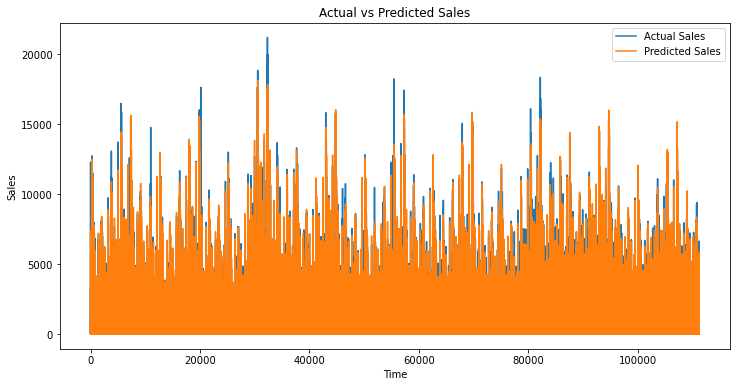

In [232]:
plt.figure(figsize=(12, 6))
plt.plot(y_sub_val.values, label='Actual Sales')
plt.plot(y_pred, label='Predicted Sales')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.title('Actual vs Predicted Sales')
plt.legend()
plt.show()

In [233]:
tabla_nueva = pd.read_csv('C:/Users/User/OneDrive - Universidad Internacional del Ecuador/Escritorio/Master Primer Semestre/Software for IA/Project 1/test.csv', parse_dates=['date'])
tabla_nueva

,id,date,store_nbr,family,onpromotion
0,3000888,2017-08-16,1,AUTOMOTIVE,0
1,3000889,2017-08-16,1,BABY CARE,0
2,3000890,2017-08-16,1,BEAUTY,2
3,3000891,2017-08-16,1,BEVERAGES,20
4,3000892,2017-08-16,1,BOOKS,0
...,...,...,...,...,...
28507,3029395,2017-08-31,9,POULTRY,1
28508,3029396,2017-08-31,9,PREPARED FOODS,0
28509,3029397,2017-08-31,9,PRODUCE,1
28510,3029398,2017-08-31,9,SCHOOL AND OFFICE SUPPLIES,9


In [234]:
y_test_pred = final_model.predict(test_data_encoded)

In [243]:
test_data_encoded

,store_nbr,family,onpromotion,city,state,type,cluster,dcoilwtico,weekday,year,...,sales_lag_14,sales_lag_30,sales_roll_mean_7,sales_roll_mean_30,sales_ewm_alpha_095_lag_7,sales_ewm_alpha_095_lag_30,sales_ewm_alpha_09_lag_7,sales_ewm_alpha_09_lag_30,sales_ewm_alpha_08_lag_7,sales_ewm_alpha_08_lag_30
2780316,0,0,0,18,12,3,4,46.80,2,2017,...,4.0,2.000000,7.028078,6.576761,6.857370e+00,2.009781,6.728925e+00,2.038480,6.511056e+00,2.151308e+00
2780317,0,1,0,18,12,3,4,46.80,2,2017,...,0.0,0.000000,-0.780095,1.424639,0.000000e+00,0.000000,0.000000e+00,0.000000,8.942588e-322,1.064056e-305
2780318,0,2,2,18,12,3,4,46.80,2,2017,...,2.0,5.000000,2.553573,-0.660333,3.907132e+00,4.857144,3.827138e+00,4.727317,3.698718e+00,4.501235e+00
2780319,0,3,20,18,12,3,4,46.80,2,2017,...,2645.0,2381.000000,1755.320339,2069.534184,2.315387e+03,2318.700769,2.317378e+03,2262.147948,2.312079e+03,2.166968e+03
2780320,0,4,0,18,12,3,4,46.80,2,2017,...,0.0,1.000000,1.040751,3.134128,1.855469e-12,0.950238,9.000000e-10,0.901801,4.096000e-07,8.128513e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2808823,53,28,1,18,12,1,13,47.26,3,2017,...,0.0,570.196000,0.000000,445.950872,4.307176e+02,565.318991,4.239357e+02,560.611289,4.122763e+02,5.514217e+02
2808824,53,29,0,18,12,1,13,47.26,3,2017,...,0.0,50.462997,0.000000,114.808586,1.525120e+02,51.246066,1.504432e+02,52.444705,1.462783e+02,5.602257e+01
2808825,53,30,1,18,12,1,13,47.26,3,2017,...,0.0,2470.461000,0.000000,1662.489077,2.366993e+03,2423.706728,2.315776e+03,2378.620204,2.217030e+03,2.292419e+03
2808826,53,31,9,18,12,1,13,47.26,3,2017,...,0.0,203.000000,0.000000,155.241974,1.240873e+02,195.609900,1.272182e+02,188.128407,1.334267e+02,1.728145e+02


In [235]:
tabla_nueva['sales'] = y_test_pred

In [238]:
display = tabla_nueva.copy()
stores = display.groupby(['date', 'store_nbr'], as_index=False)['sales'].sum()

In [240]:
px.line(stores, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

In [244]:
final_model.save_model("xgboost_model_sales.json") 

In [242]:
test_data_encoded.to_csv('Test_sales.csv', index=False)